In [1]:
import pandas as pd
import numpy as np
import zipfile
import os
import shutil
import matplotlib.pyplot as plt
from PIL import Image
from dask import bag, diagnostics
import random
import tensorflow as tf
from tensorflow import keras
import keras.preprocessing.image
from tensorflow.keras.preprocessing.image import save_img, ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import class_weight
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image



## Data Importing & EDA

In [2]:
zip_path = 'pikachu_dataset.zip'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall()

# List the contents of the extracted directory
extracted_files = os.listdir()
extracted_files

['Picachu.ipynb', 'pikachu_dataset.zip', '.DS_Store', 'pikachu_dataset']

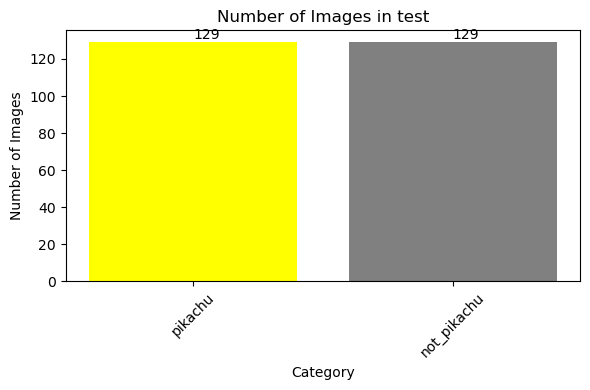

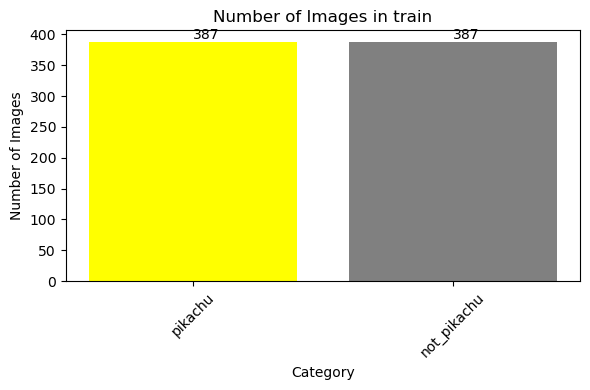

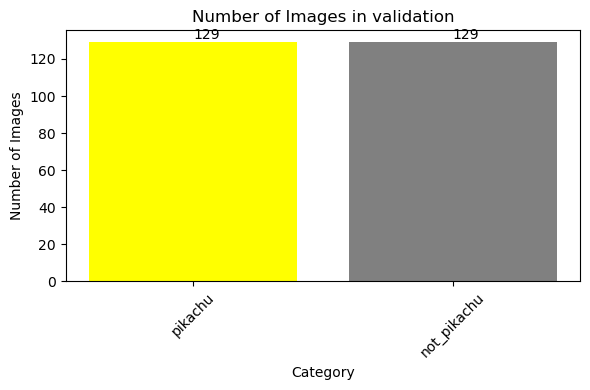

In [3]:
def count_and_plot_images(dataset_path):
    categories = ['test', 'train', 'validation']
    subcategories = ['pikachu', 'not_pikachu']
    
    # Dictionary to hold the count of images per category and subcategory
    image_counts = {category: {subcategory: 0 for subcategory in subcategories} for category in categories}
    
    # Count images in each subcategory directory for each category
    for category in categories:
        for subcategory in subcategories:
            path = os.path.join(dataset_path, category, subcategory)
            if os.path.exists(path):
                # List all files in the directory and count them
                count = len([name for name in os.listdir(path) if os.path.isfile(os.path.join(path, name))])
                image_counts[category][subcategory] = count
    
    # Plotting
    for category, counts in image_counts.items():
        plt.figure(figsize=(6, 4))
        bars = plt.bar(counts.keys(), counts.values(), color=['yellow', 'gray'])
        plt.xlabel('Category')
        plt.ylabel('Number of Images')
        plt.title(f'Number of Images in {category}')
        plt.xticks(rotation=45)
        plt.tight_layout()
        
        # Annotate the number of images on top of each bar
        for bar in bars:
            yval = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom')  # va: vertical alignment
        
        plt.show()

# Call the function with the path to the dataset
count_and_plot_images('pikachu_dataset')


In [4]:
# Define the source and destination paths
validation_pikachu_src = os.path.join('pikachu_dataset', 'validation', 'pikachu')
validation_not_pikachu_src = os.path.join('pikachu_dataset', 'validation', 'not_pikachu')
train_pikachu_dest = os.path.join('pikachu_dataset', 'train', 'pikachu')
train_not_pikachu_dest = os.path.join('pikachu_dataset', 'train', 'not_pikachu')

# Move 'pikachu' images from validation to train folder
for file_name in os.listdir(validation_pikachu_src):
    src_file_path = os.path.join(validation_pikachu_src, file_name)
    dest_file_path = os.path.join(train_pikachu_dest, file_name)
    shutil.move(src_file_path, dest_file_path)

# Move 'not_pikachu' images from validation to train folder
for file_name in os.listdir(validation_not_pikachu_src):
    src_file_path = os.path.join(validation_not_pikachu_src, file_name)
    dest_file_path = os.path.join(train_not_pikachu_dest, file_name)
    shutil.move(src_file_path, dest_file_path)


# Define the path to the validation folder
validation_folder_path = os.path.join('pikachu_dataset', 'validation')
if os.path.exists(validation_folder_path):
    shutil.rmtree(validation_folder_path)


[########################################] | 100% Completed | 1.67 ss


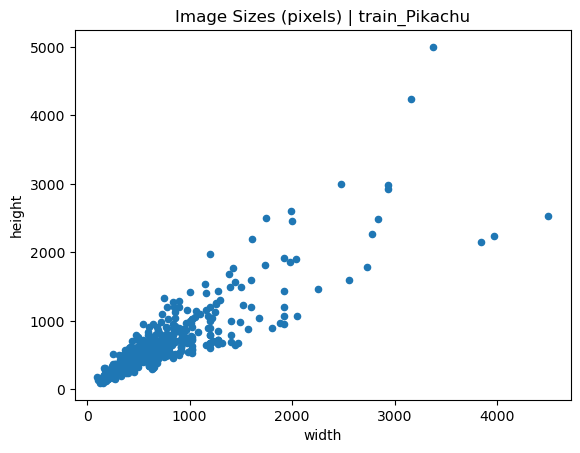

[########################################] | 100% Completed | 1.47 ss


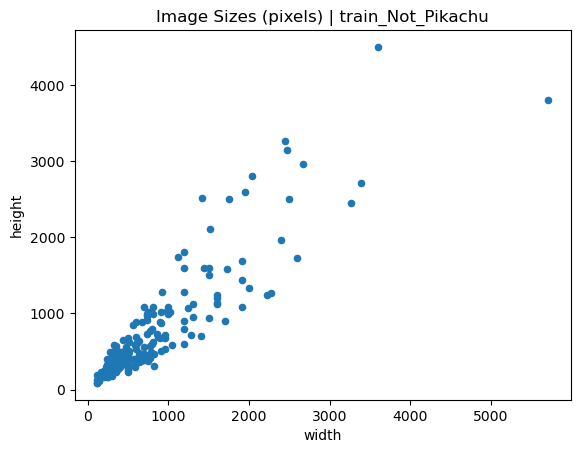

[########################################] | 100% Completed | 1.08 sms


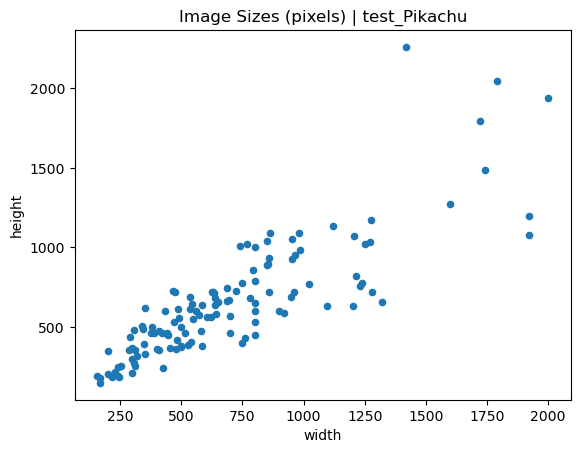

[########################################] | 100% Completed | 1.12 sms


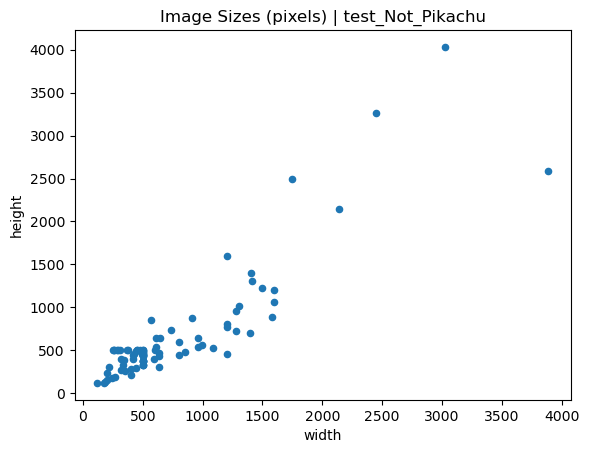

In [5]:
# Plot the image size distribution for the pikachu_dataset
directories = {
    'train_Pikachu': 'pikachu_dataset/train/pikachu',
    'train_Not_Pikachu': 'pikachu_dataset/train/not_pikachu',
    'test_Pikachu': 'pikachu_dataset/test/pikachu',
    'test_Not_Pikachu': 'pikachu_dataset/test/not_pikachu'
}

def get_dims(file):
    '''Returns dimensions for an RGB image'''
    im = Image.open(file)
    arr = np.array(im)
    h, w, d = arr.shape
    return h, w

all_dims = []
for n, d in directories.items():
    filepath = d
    filelist = [os.path.join(filepath, f) for f in os.listdir(filepath) if os.path.isfile(os.path.join(filepath, f))]
    dims = bag.from_sequence(filelist).map(get_dims)
    with diagnostics.ProgressBar():
        dims = dims.compute()
    dim_df = pd.DataFrame(dims, columns=['height', 'width'])
    sizes = dim_df.groupby(['height', 'width']).size().reset_index().rename(columns={0: 'count'})
    sizes.plot.scatter(x='width', y='height')
    plt.title('Image Sizes (pixels) | {}'.format(n))
    plt.show()

Sample images from train_Pikachu:


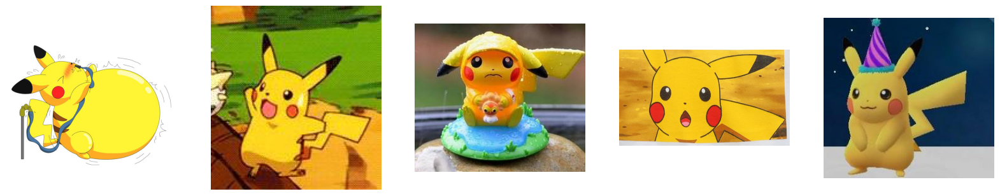

Sample images from train_Not_Pikachu:


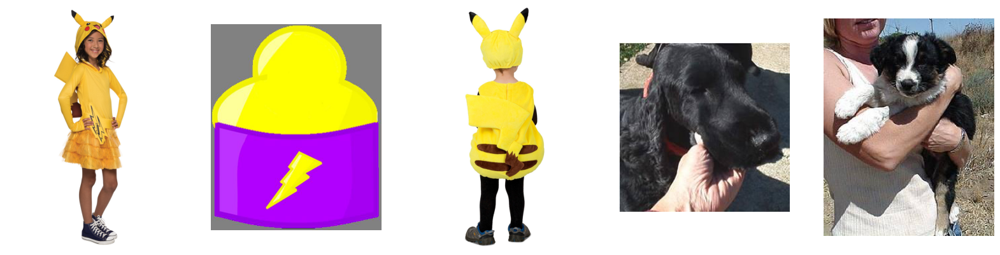

Sample images from test_Pikachu:


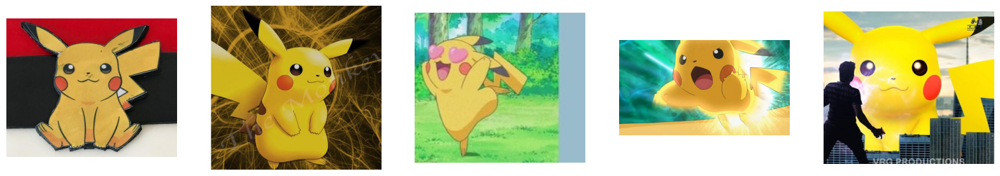

Sample images from test_Not_Pikachu:


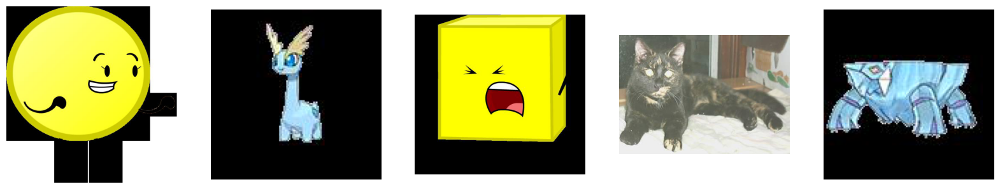

In [6]:
def display_sample_images(directory, num_samples=5):
    '''Displays a sample of images from the specified directory'''
    files = [os.path.join(directory, f) for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]
    sample_files = random.sample(files, min(num_samples, len(files)))
    
    fig, axes = plt.subplots(1, len(sample_files), figsize=(20, 10))
    for ax, img_file in zip(axes, sample_files):
        img = plt.imread(img_file)
        ax.imshow(img)
        ax.axis('off')
    plt.show()

# Display a sampling of images for each class
for class_name, directory in directories.items():
    print(f"Sample images from {class_name}:")
    display_sample_images(directory)



In [7]:
import os
from PIL import Image

def resize_images(directory, target_size=(120, 120)):
    '''Resizes all images in the specified directory to the target size'''
    for root, _, files in os.walk(directory):
        for file in files:
            if file.endswith(('jpg', 'jpeg', 'png')):
                file_path = os.path.join(root, file)
                with Image.open(file_path) as img:
                    img = img.resize(target_size, Image.LANCZOS)
                    img.save(file_path)

# Apply the resizing function to all directories
for dir_path in directories.values():
    resize_images(dir_path)

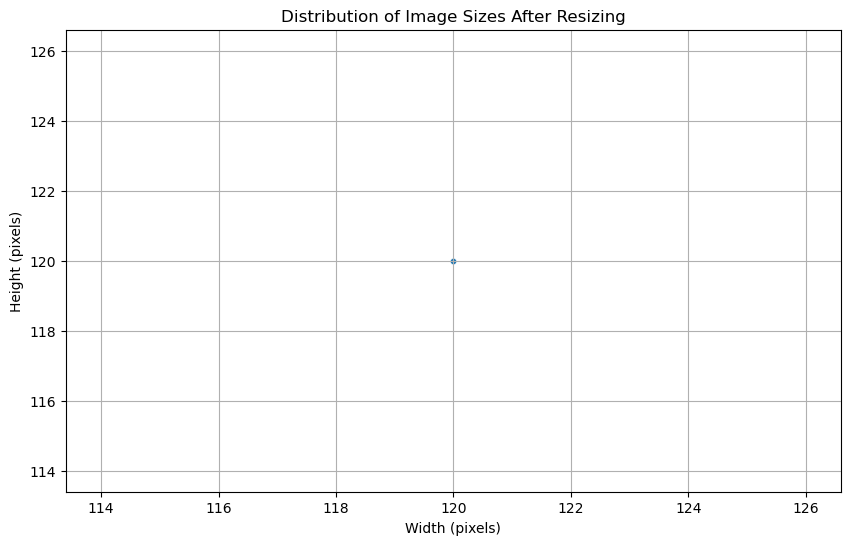

In [8]:
# Check the size distribution of images after resizing
resized_sizes = []
for dir_path in directories.values():
    for root, _, files in os.walk(dir_path):
        for file in files:
            if file.endswith(('jpg', 'jpeg', 'png')):
                file_path = os.path.join(root, file)
                with Image.open(file_path) as img:
                    resized_sizes.append(img.size)

# Convert list of sizes to DataFrame
resized_sizes_df = pd.DataFrame(resized_sizes, columns=['width', 'height'])

# Group by size and count the occurrences
resized_sizes_count = resized_sizes_df.groupby(['width', 'height']).size().reset_index(name='count')

# Plotting the size distribution
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.scatterplot(data=resized_sizes_count, x='width', y='height', size='count', legend=None, sizes=(20, 200))
plt.title('Distribution of Image Sizes After Resizing')
plt.xlabel('Width (pixels)')
plt.ylabel('Height (pixels)')
plt.grid(True)
plt.show()


Sample images from train_Pikachu:


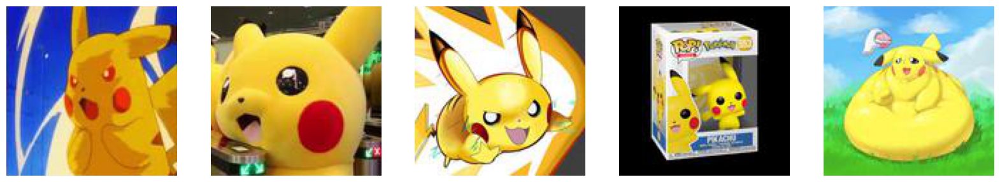

Sample images from train_Not_Pikachu:


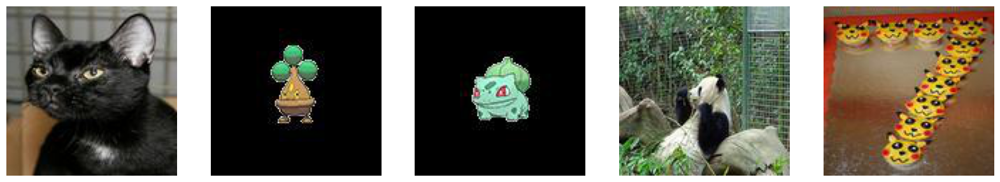

Sample images from test_Pikachu:


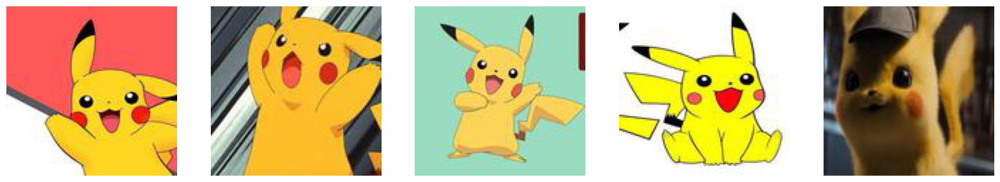

Sample images from test_Not_Pikachu:


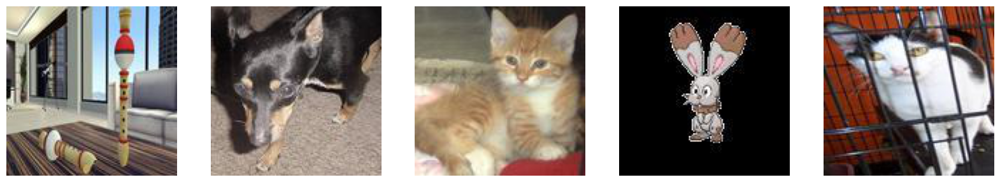

In [9]:
def display_sample_images(directory, num_samples=5):
    '''Displays a sample of images from the specified directory'''
    files = [os.path.join(directory, f) for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]
    sample_files = random.sample(files, min(num_samples, len(files)))
    
    fig, axes = plt.subplots(1, len(sample_files), figsize=(20, 10))
    for ax, img_file in zip(axes, sample_files):
        img = plt.imread(img_file)
        ax.imshow(img)
        ax.axis('off')
    plt.show()

# Display a sampling of images for each class
for class_name, directory in directories.items():
    print(f"Sample images from {class_name}:")
    display_sample_images(directory)


## Data Processing


In [10]:
train_datagen = ImageDataGenerator(
    rescale=1./255,          # Normalize pixel values
    shear_range=0.2,         # Shear Intensity (Shear angle in counter-clockwise direction in degrees)
    zoom_range=0.2,          # Randomly zoom image 
    width_shift_range=0.2,   # Randomly shift images horizontally by 20% of the width
    height_shift_range=0.2,  # Randomly shift images vertically by 20% of the height
    fill_mode='nearest',     # Strategy for filling in newly created pixels
    horizontal_flip=True,    # Randomly flip images horizontally
    validation_split=0.2     # Fraction of images reserved for validation
)

validation_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2 )

In [11]:
# Define the base directory paths
base_dir = 'pikachu_dataset'
train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')

train_generator = train_datagen.flow_from_directory(
    train_dir,  
    target_size=(120, 120), 
    batch_size=32,
    class_mode='categorical',
    subset='training'  # Set for training data
)

validation_generator = validation_datagen.flow_from_directory(
    train_dir,  
    target_size=(120, 120), 
    batch_size=32,
    class_mode='categorical',
    subset='validation' # Set for validation data'
)



Found 826 images belonging to 2 classes.
Found 206 images belonging to 2 classes.


In [12]:
test_datagen = ImageDataGenerator (rescale=1./255)

test_generator = train_datagen.flow_from_directory(
    test_dir,
    target_size=(120, 120), 
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)


Found 258 images belonging to 2 classes.


In [13]:
# Get a batch of data from the training generator
sample_training_images, _ = next(train_generator)

# Print the shape of the first image in the batch
print("Shape of each training observation:", sample_training_images[0].shape)
# Print the number of classes in the training data
num_classes = len(train_generator.class_indices)
print("Number of classes to predict on:", num_classes)

Shape of each training observation: (120, 120, 3)
Number of classes to predict on: 2


In [14]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization

model = Sequential()

# Convolutional layer 1
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(120, 120, 3)))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

# Convolutional layer 2
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

# model.add(Conv2D(128, (3, 3), activation='relu'))
# model.add(BatchNormalization())
# model.add(MaxPooling2D(pool_size=(2, 2)))

# Flattening the layers
model.add(Flatten())

# Dense layer
model.add(Dense(128, activation='relu'))  # Adjusted number of units
model.add(Dropout(0.5))  # Dropout to prevent overfitting

# Output layer for binary classification
model.add(Dense(2, activation='sigmoid'))  

# Compile the model with binary crossentropy
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

/Users/zhengliangjiang/anaconda3/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [15]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 118, 118, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 118, 118, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 59, 59, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 57, 57, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 28, 28, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 50176)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     6,422,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,442,434 (24.58 MB)

 Trainable params: 6,442,370 (24.58 MB)

 Non-trainable params: 64 (256.00 B)

In [16]:
history = model.fit(
    train_generator,
    epochs=20,
    validation_data=validation_generator,
    verbose=1
)


Epoch 1/20


/Users/zhengliangjiang/anaconda3/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


26/26 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - accuracy: 0.6557 - loss: 2.4143 - val_accuracy: 0.5243 - val_loss: 0.6707
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.7704 - loss: 0.4797 - val_accuracy: 0.6748 - val_loss: 0.6474
Epoch 3/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.8412 - loss: 0.4027 - val_accuracy: 0.5825 - val_loss: 0.6548
Epoch 4/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step - accuracy: 0.8236 - loss: 0.4443 - val_accuracy: 0.6699 - val_loss: 0.6191
Epoch 5/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.8079 - loss: 0.4515 - val_accuracy: 0.7379 - val_loss: 0.5871
Epoch 6/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.7977 - loss: 0.4263 - val_accuracy: 0.7718 - val_loss: 0.5583
Epoch 7/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 80ms/step - accuracy: 0.8345 - loss: 0.3884 - val_accuracy: 0.7573 - val_loss: 0.5309
Epoch 8/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 2s 82ms/step - accuracy: 0.8072 - loss: 0.4196 - val_accuracy: 0.7913 - val_loss: 0.

In [17]:
model.save("pikachu_1.keras")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


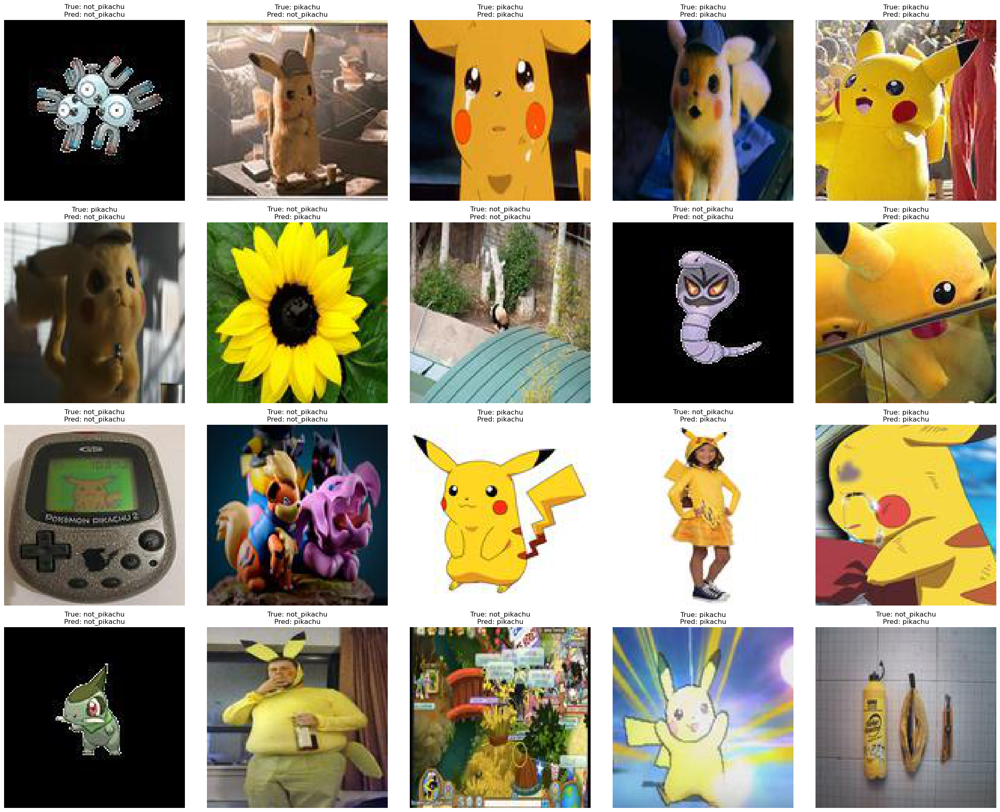

In [18]:
# Function to collect all predictions and images
def collect_predictions_and_images(generator, model):
    images = []
    all_predictions = []
    all_true_labels = []
    
    # Iterate over all batches in the generator
    for x, y in generator:
        # Predict current batch
        preds = model.predict(x)
        predicted_classes = np.argmax(preds, axis=1)
        true_classes = np.argmax(y, axis=1)
        
        # Store predictions, true labels, and images
        images.extend(x)
        all_predictions.extend(predicted_classes)
        all_true_labels.extend(true_classes)
        
        # Check if we've gone through all images
        if len(all_true_labels) >= generator.samples:
            break
    
    return images, all_predictions, all_true_labels

# Collect data
images, predicted_classes, true_classes = collect_predictions_and_images(validation_generator, model)

# Function to display a sample of images with predictions
def display_sample_predictions(images, predicted_classes, true_classes, num_samples=20):
    sample_indices = np.random.choice(len(images), num_samples, replace=False)
    
    plt.figure(figsize=(25, 20))
    for i, idx in enumerate(sample_indices):
        plt.subplot(4, 5, i + 1)  # 4 rows, 5 columns
        img = images[idx]
        img = (img * 255).astype('uint8')  # Rescale and convert to uint8
        plt.imshow(img)
        true_label = list(validation_generator.class_indices.keys())[true_classes[idx]]
        pred_label = list(validation_generator.class_indices.keys())[predicted_classes[idx]]
        plt.title(f"True: {true_label}\nPred: {pred_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Display sample images with predictions
display_sample_predictions(images, predicted_classes, true_classes)

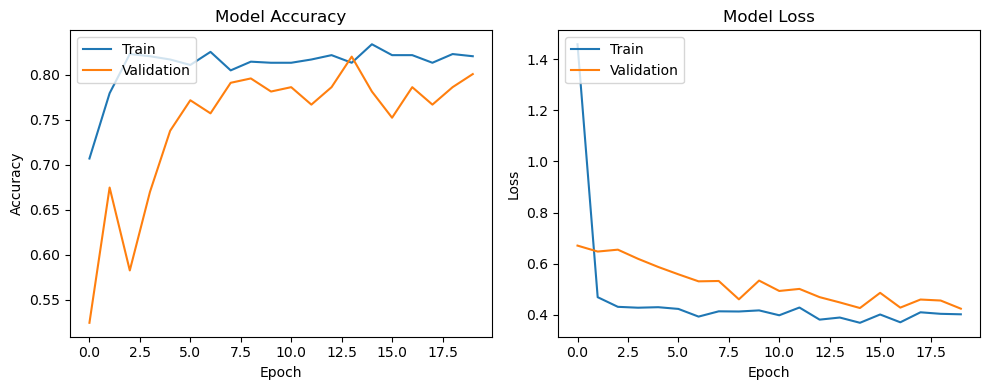

In [19]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

In [20]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test accuracy: {test_accuracy:.2f}")

from sklearn.metrics import classification_report

# Predict classes
predictions = model.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)

# Get true classes
true_classes = test_generator.classes

# Generate classification report
report = classification_report(true_classes, predicted_classes, target_names=test_generator.class_indices.keys())
print(report)


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.7949 - loss: 0.3739
Test accuracy: 0.83
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
              precision    recall  f1-score   support

 not_pikachu       0.91      0.70      0.79       129
     pikachu       0.75      0.93      0.83       129

    accuracy                           0.81       258
   macro avg       0.83      0.81      0.81       258
weighted avg       0.83      0.81      0.81       258



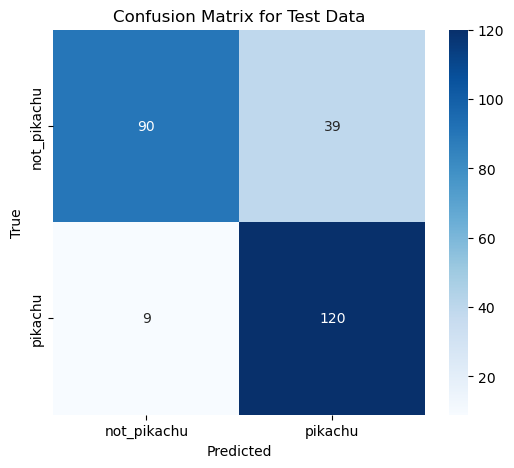

In [21]:
# Generate confusion matrix for the test data
conf_matrix = confusion_matrix(true_classes, predicted_classes)

# Plot confusion matrix for the test data
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix for Test Data')
plt.show()

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Total number of misclassified images: 49


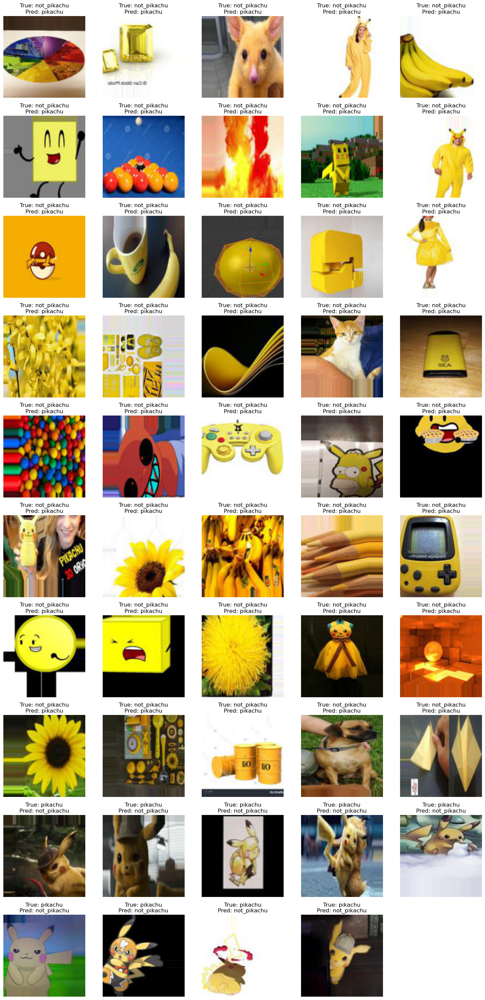

In [22]:
# Predict classes for test dataset
test_predictions = model.predict(test_generator)
test_predicted_classes = np.argmax(test_predictions, axis=1)

# Get true classes for test dataset
test_true_classes = test_generator.classes

# Identify misclassified samples
misclassified_indices = np.where(test_predicted_classes != test_true_classes)[0]
total_misclassified = len(misclassified_indices)
print(f"Total number of misclassified images: {total_misclassified}")

# Function to display misclassified images
def display_misclassified_images(generator, misclassified_indices, images_per_row=5):
    num_samples = len(misclassified_indices)
    num_rows = (num_samples + images_per_row - 1) // images_per_row  # Calculate number of rows needed
    plt.figure(figsize=(images_per_row * 3, num_rows * 3))
    
    for i, index in enumerate(misclassified_indices):
        # Calculate batch index and image index within the batch
        batch_index = index // generator.batch_size
        image_index = index % generator.batch_size
        
        # Reset the generator and advance to the correct batch
        generator.reset()
        for _ in range(batch_index + 1):
            batch_x, batch_y = next(generator)
        
        img = batch_x[image_index]
        img = (img * 255).astype("uint8")  # Rescale image to [0, 255] and convert to uint8
        true_label = list(generator.class_indices.keys())[np.argmax(batch_y[image_index])]
        predicted_label = list(generator.class_indices.keys())[test_predicted_classes[index]]
        
        plt.subplot(num_rows, images_per_row, i + 1)
        plt.imshow(img)
        plt.title(f"True: {true_label}\nPred: {predicted_label}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Display all misclassified images
display_misclassified_images(test_generator, misclassified_indices)

Reasons of misclassification: 
1. Similar Color and Texture:
Many of the misclassified images have a dominant yellow color, which is similar to Pikachu's color. The model might be relying heavily on color features, leading to confusion with other yellow objects.
2. Background and Context:
Some images might have backgrounds or contexts that are visually similar to those in the training images of Pikachu. For example, images with yellow toys or objects in a similar setting might confuse the model.
3. Shape and Structure:
The model might be confusing objects with similar shapes or structures. For instance, some yellow objects or toys might have shapes that resemble parts of Pikachu, leading to misclassification.
4. Complex Backgrounds:
Images with complex or cluttered backgrounds can confuse the model, especially if the training images had simpler backgrounds.
5. Low Resolution or Blurriness:
Some images might be of low resolution or blurry, making it difficult for the model to extract meaningful features.
6. Pose and Orientation:
Variations in the pose or orientation of Pikachu in the images might not have been well-represented in the training data, leading to misclassifications.

In [23]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import class_weight


In [24]:
class_weights = class_weight.compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)
class_weights = dict(enumerate(class_weights))

# Load the VGG16 model, excluding the top layers
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(120, 120, 3))

# Add custom top layers
x = base_model.output
x = Flatten()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='sigmoid')(x)

# Create the final model
model_1 = Model(inputs=base_model.input, outputs=predictions)

# Freeze the layers of the base model
for layer in base_model.layers:
    layer.trainable = False

# Compile the model
model_1.compile(optimizer=Adam(learning_rate=1e-4), loss='binary_crossentropy', metrics=['accuracy'])

model_1.summary()


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 120, 120, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 120, 120, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 120, 120, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 60, 60, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 60, 60, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 30, 30, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 30, 30, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 30, 30, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 15, 15, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 15, 15, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 15, 15, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 15, 15, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 7, 7, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 7, 7, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 7, 7, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 3, 3, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 4608)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 17,075,522 (65.14 MB)

 Trainable params: 2,360,834 (9.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [25]:
# Train the model
history_1 = model_1.fit(
    train_generator,
    epochs=30,
    validation_data=validation_generator,
    class_weight=class_weights,
    verbose=1
)

Epoch 1/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 412ms/step - accuracy: 0.6287 - loss: 0.6779 - val_accuracy: 0.8252 - val_loss: 0.3715
Epoch 2/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 429ms/step - accuracy: 0.8269 - loss: 0.3861 - val_accuracy: 0.8544 - val_loss: 0.3385
Epoch 3/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 12s 435ms/step - accuracy: 0.9093 - loss: 0.2678 - val_accuracy: 0.8689 - val_loss: 0.3237
Epoch 4/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 425ms/step - accuracy: 0.8973 - loss: 0.2706 - val_accuracy: 0.8786 - val_loss: 0.3084
Epoch 5/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 430ms/step - accuracy: 0.9167 - loss: 0.2227 - val_accuracy: 0.8835 - val_loss: 0.3028
Epoch 6/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 416ms/step - accuracy: 0.9067 - loss: 0.2196 - val_accuracy: 0.8883 - val_loss: 0.3004
Epoch 7/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 413ms/step - accuracy: 0.9300 - loss: 0.1960 - val_accuracy: 0.8835 - val_loss: 0.2933
Epoch 8/30
26/26 ━━━━━━━━━━━━━━━━━━━━ 11s 421ms/step - accuracy: 0.9354 - loss: 0.1784 - val_accu

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


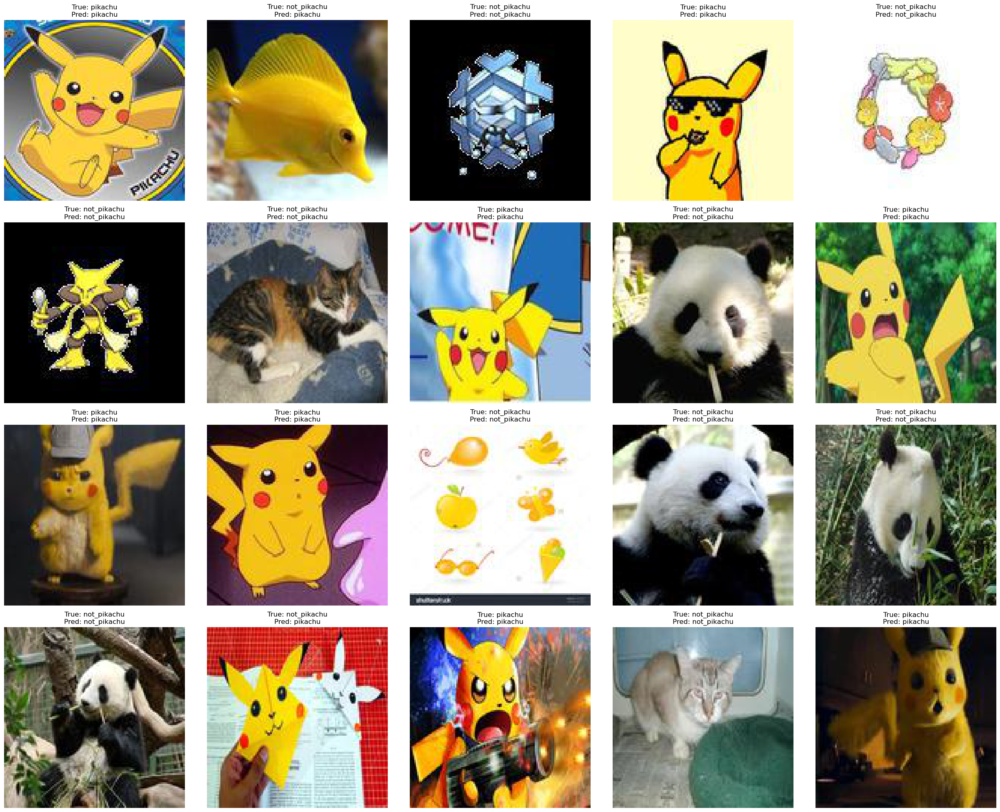

In [26]:
# Collect data
images, predicted_classes, true_classes = collect_predictions_and_images(validation_generator, model_1)

# Display sample images with predictions
display_sample_predictions(images, predicted_classes, true_classes)


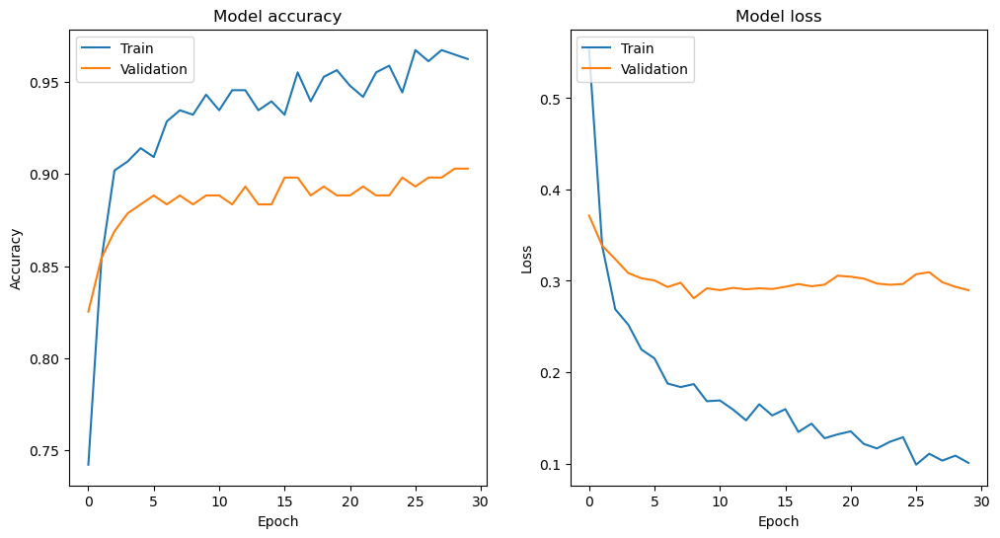

In [27]:
# Plotting the loss and accuracy for the model_1
plt.figure(figsize=(12, 6))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history_1.history['accuracy'])
plt.plot(history_1.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_1.history['loss'])
plt.plot(history_1.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.show()


In [28]:
# Evaluate the model on the test data
test_loss, test_accuracy = model_1.evaluate(test_generator)
print(f"Test accuracy: {test_accuracy:.2f}")

# Predict classes on the test data
predictions = model_1.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)

# Get true classes from the test data
true_classes = test_generator.classes

# Generate and print the classification report
from sklearn.metrics import classification_report
report = classification_report(true_classes, predicted_classes, target_names=test_generator.class_indices.keys())
print(report)


9/9 ━━━━━━━━━━━━━━━━━━━━ 3s 279ms/step - accuracy: 0.9502 - loss: 0.1388
Test accuracy: 0.93
9/9 ━━━━━━━━━━━━━━━━━━━━ 3s 289ms/step
              precision    recall  f1-score   support

 not_pikachu       0.93      0.96      0.94       129
     pikachu       0.96      0.92      0.94       129

    accuracy                           0.94       258
   macro avg       0.94      0.94      0.94       258
weighted avg       0.94      0.94      0.94       258



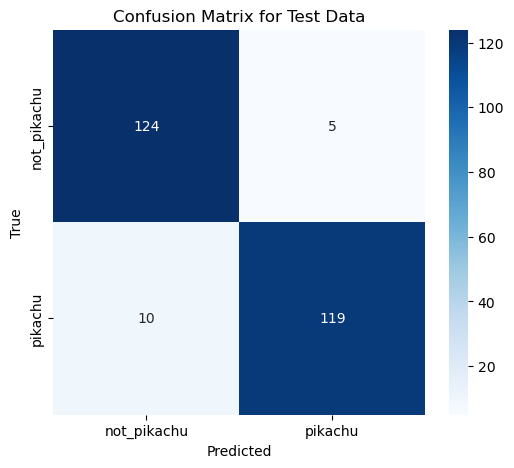

In [29]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Generate confusion matrix for the test data
conf_matrix = confusion_matrix(true_classes, predicted_classes)

# Plot confusion matrix for the test data
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=test_generator.class_indices.keys(), yticklabels=test_generator.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix for Test Data')
plt.show()


9/9 ━━━━━━━━━━━━━━━━━━━━ 3s 284ms/step
Total number of misclassified images: 25


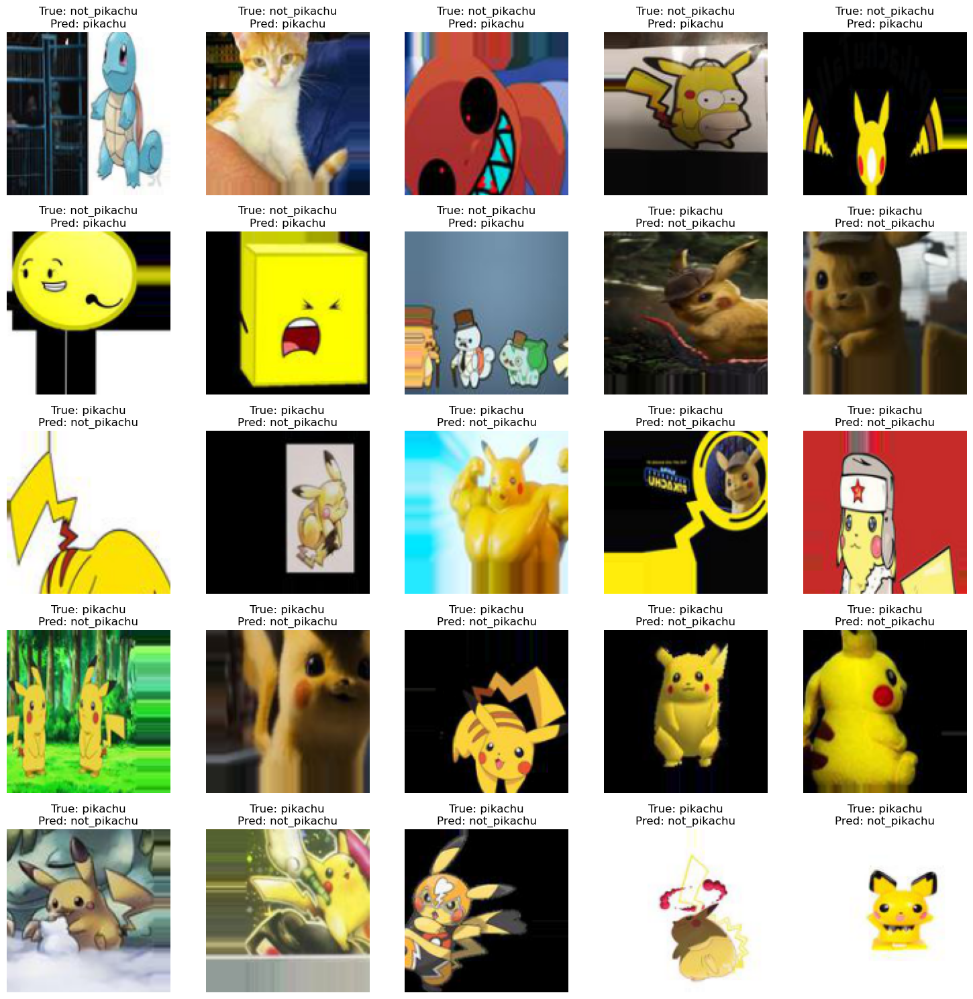

In [30]:
# Predict classes for test dataset
test_predictions = model_1.predict(test_generator)
test_predicted_classes = np.argmax(test_predictions, axis=1)

# Get true classes for test dataset
test_true_classes = test_generator.classes

# Identify misclassified samples
misclassified_indices = np.where(test_predicted_classes != test_true_classes)[0]
total_misclassified = len(misclassified_indices)
print(f"Total number of misclassified images: {total_misclassified}")

# Display all misclassified images
display_misclassified_images(test_generator, misclassified_indices)


In [31]:
# Save the model
model_1.save('pikachu_2.keras')


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 120, 120, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 120, 120, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 120, 120, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 60, 60, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 60, 60, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 30, 30, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 30, 30, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 30, 30, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 15, 15, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 15, 15, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 15, 15, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 15, 15, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 7, 7, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 7, 7, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 7, 7, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 3, 3, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 4608)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │         1,026 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 21,797,192 (83.15 MB)

 Trainable params: 2,360,834 (9.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

 Optimizer params: 4,721,670 (18.01 MB)

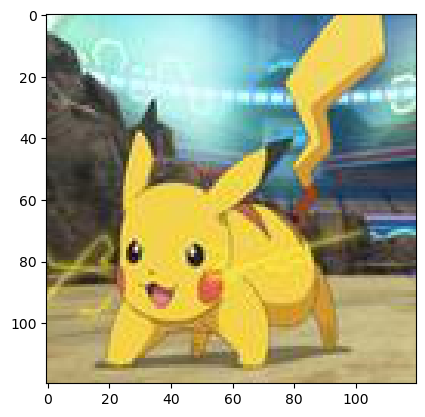

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


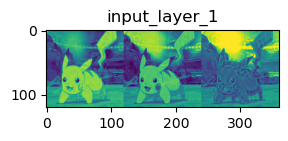

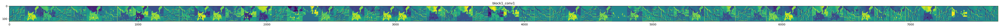

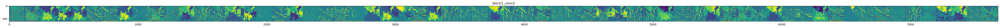

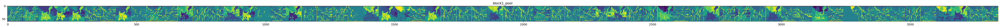

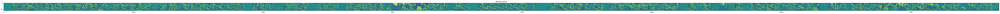

...

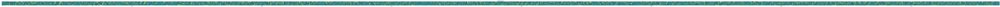

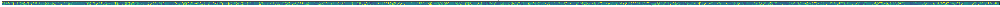

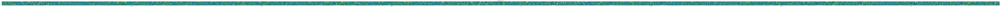

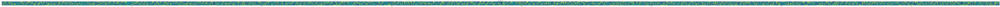

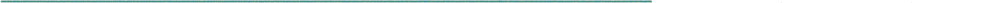

In [41]:
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

# Load the pre-trained model and display its architecture
model_path = 'pikachu_2.keras'
model = load_model(model_path)
model.summary()

# Load and preprocess the image
image_path = '/Users/zhengliangjiang/Desktop/U Chicago/2024 Spring/Machine Learning /Project/pikachu_dataset/test/pikachu/pikachu_00531.jpg'  # Replace with your image path
img = image.load_img(image_path, target_size=(120, 120))
img_tensor = image.img_to_array(img) / 255.0  # Normalize the image
img_tensor = np.expand_dims(img_tensor, axis=0)

# Display the image
plt.imshow(img_tensor[0])
plt.show()

# Extract and display the outputs of the top 12 layers
layer_outputs = [layer.output for layer in model.layers[:12]]
activation_model = Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict(img_tensor)

for layer_name, activation in zip([layer.name for layer in model.layers[:12]], activations):
    n_features = activation.shape[-1]
    size = activation.shape[1]
    display_grid = np.zeros((size, size * n_features))

    for i in range(n_features):
        x = activation[0, :, :, i]
        x -= x.mean()
        x /= x.std() + 1e-5  # Avoid division by zero
        x *= 64
        x += 128
        x = np.clip(x, 0, 255).astype('uint8')
        display_grid[:, i * size : (i + 1) * size] = x

    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    plt.show()